<a href="https://colab.research.google.com/github/ThinhNguyen209/CS336.L11.KHTN/blob/main/MAP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [101]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [106]:
import numpy as np
import pickle
import glob
from keras.preprocessing import image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.models import Model
import collections
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
from numpy.linalg import norm
# image file is truncated (13 bytes not processed)

In [39]:
# Tải model
base_model = VGG16(weights='imagenet')
model = Model(inputs = base_model.input, outputs=base_model.get_layer('fc2').output)

In [59]:
# Xử lí ảnh
def preprocess_image(path):
  img = image.load_img(path, target_size = (224, 224))
  array = image.img_to_array(img)
  array = np.expand_dims(array, axis = 0)
  array = preprocess_input(array)
  features = model.predict(array)
  return features

In [ ]:
# Rút trích deep feature của tập dataset
featureS = dict()
pathS = glob.glob('/content/drive/My Drive/Truy_van/Image_MAP/*jfif')
for img_path in pathS:
  print(img_path)
  featureS[img_path] = preprocess_image(img_path)
  

In [107]:
# Tính bằng độ đo L2 
def get_relative_images_L2(path):

  Relative_imageS = dict()
  query_feature = preprocess_image(path)

  for key in featureS:
    Relative_imageS[key] = norm(featureS[key] - query_feature)
  relative_imgs = sorted(Relative_imageS.items(), key=lambda x: x[1])
  return relative_imgs

In [116]:
# Tính bằng độ đo Cosine
def get_relative_images_Cosin(path):

  Relative_imageS = dict()
  query_feature = preprocess_image(path)

  for key in featureS:
    Relative_imageS[key] = np.inner(featureS[key], query_feature)/(norm(featureS[key])*norm(query_feature))

  relative_imgs = sorted(Relative_imageS.items(), key=lambda x: x[1])
  return relative_imgs

In [113]:
# Tính bằng độ đo tích vô hướng
def get_relative_images_Inner_product(path):

  Relative_imageS = dict()
  query_feature = preprocess_image(path)

  for key in featureS:
    Relative_imageS[key] = np.inner(featureS[key], query_feature)
  relative_imgs = sorted(Relative_imageS.items(), key=lambda x: x[1])
  return relative_imgs

In [97]:
# Viết hàm AP
def AP(relationS,total):
  IndexS = np.where(relationS == 1)[0]+1
  TimeS = np.arange(np.sum(relationS == 1))+1
  return np.sum(TimeS/IndexS)/total

In [103]:
# Tập query
queryS = ['cmc', 'ntdb', 'bosua', 'rbt', 'tp', 'cb']
dictionarieS = {'cmc': 'Chùa một cột', 'ntdb': 'Nhà thờ đức bà', 'bosua':'Bò sữa', 'rbt':'Ruộng bậc thang','tp':'Tay phật - Đà Nẵng','cb':'Chùa bà -Bình Dương'}


Chùa một cột


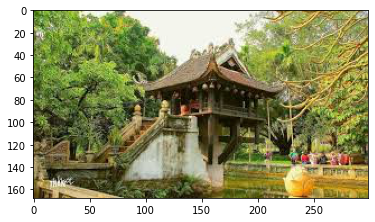

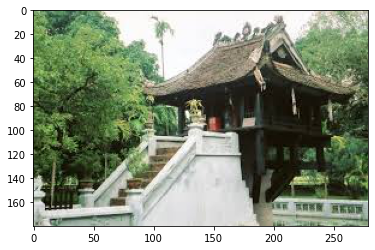

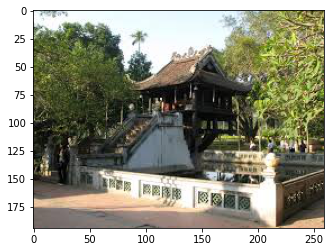

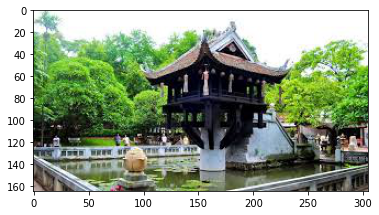

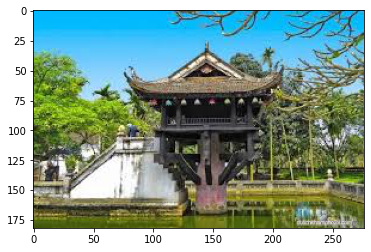

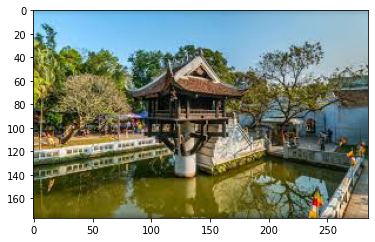

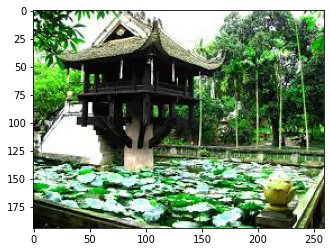

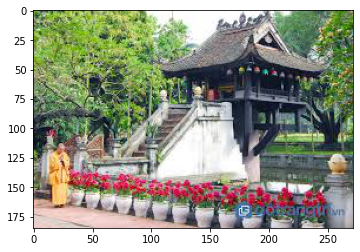

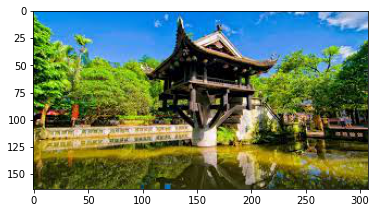

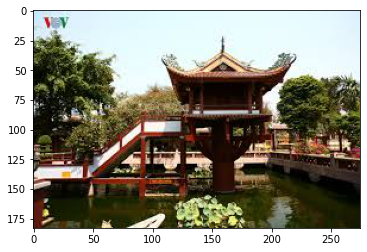

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Nhà thờ đức bà


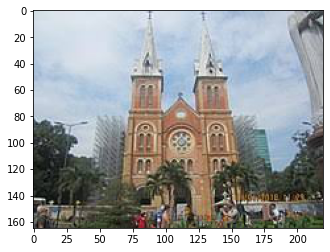

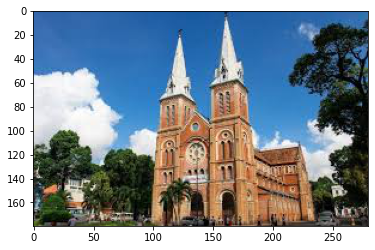

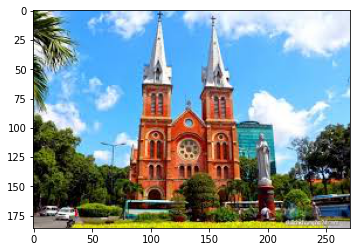

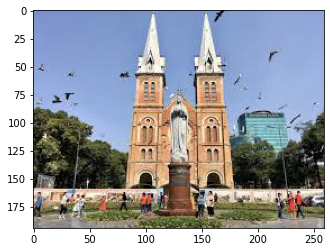

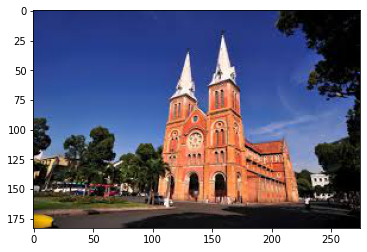

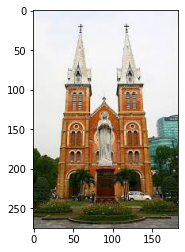

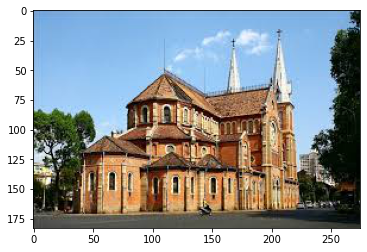

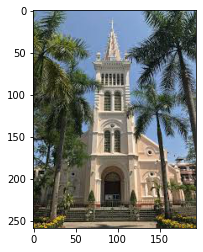

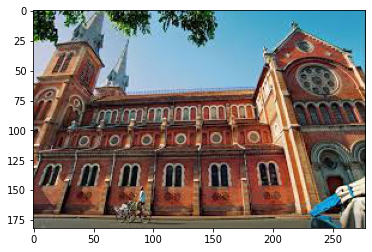

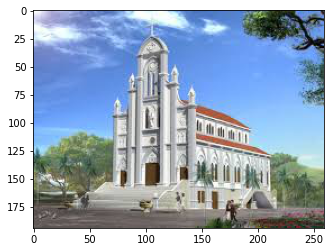

[1, 1, 1, 1, 1, 1, 1, 0, 1, 0]
0.788888888888889

Bò sữa


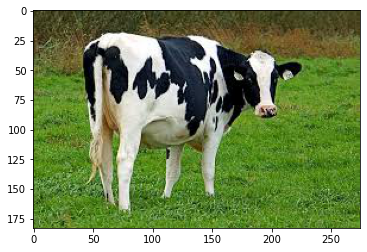

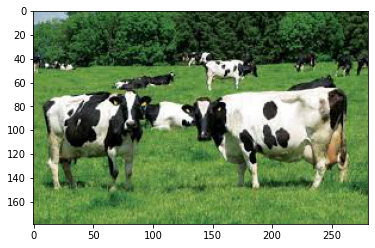

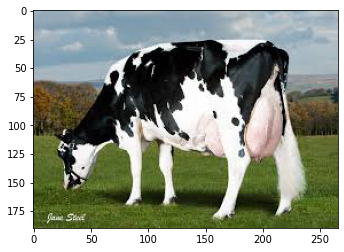

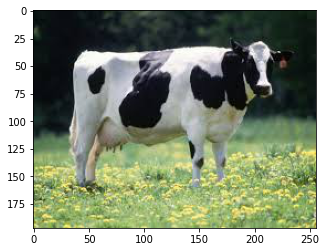

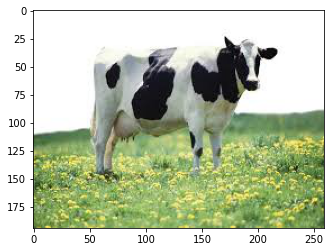

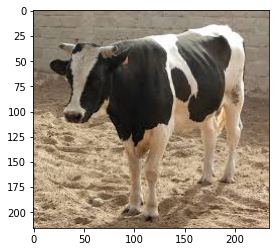

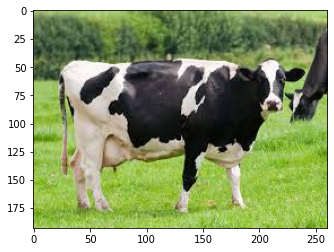

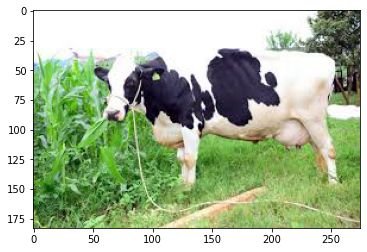

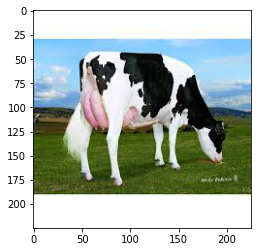

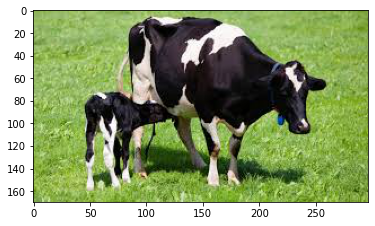

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Ruộng bậc thang


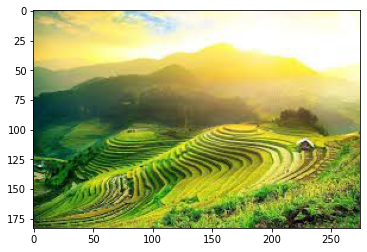

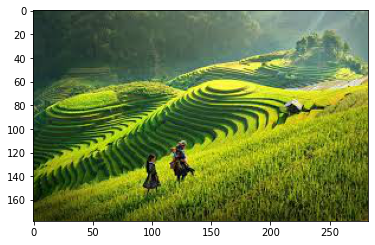

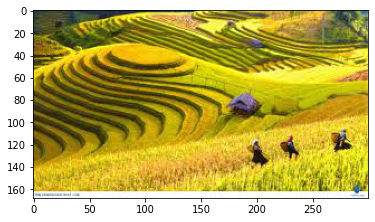

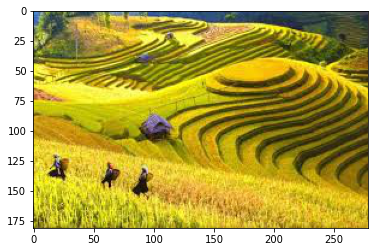

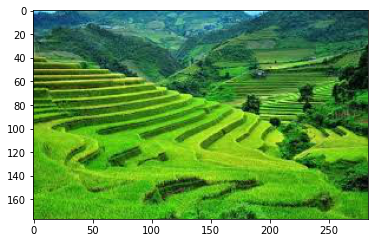

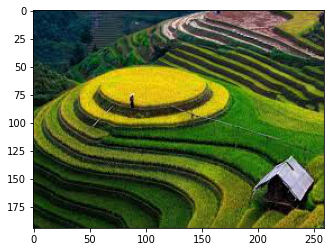

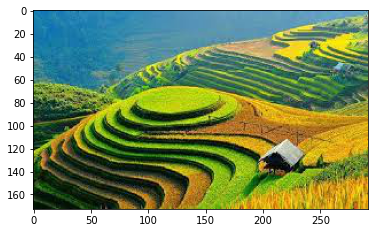

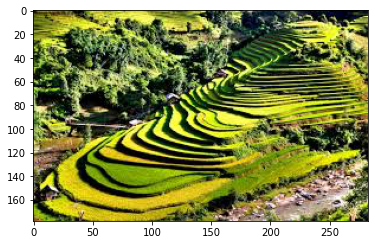

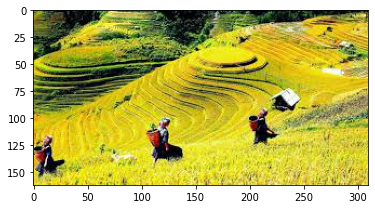

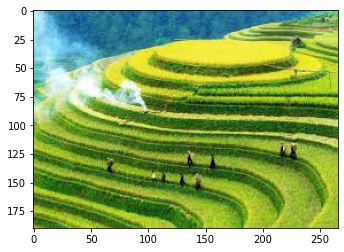

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Tay phật - Đà Nẵng


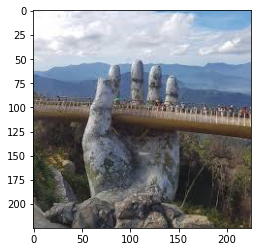

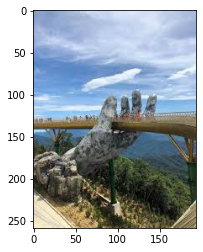

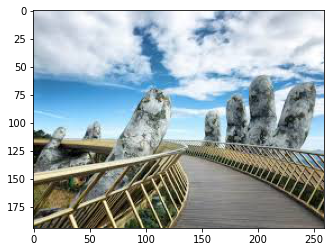

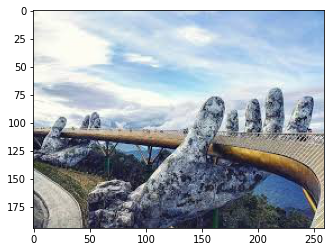

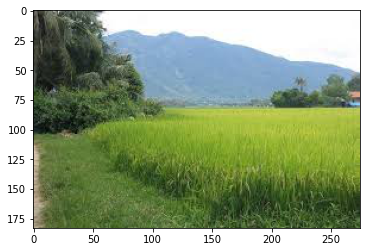

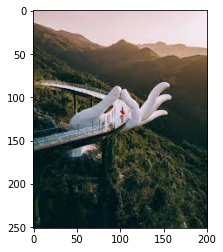

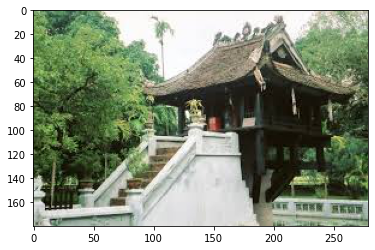

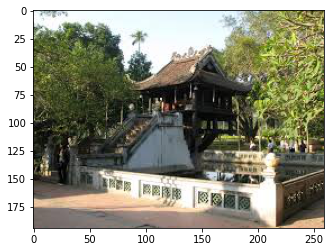

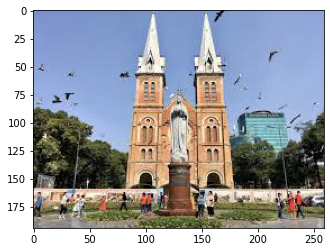

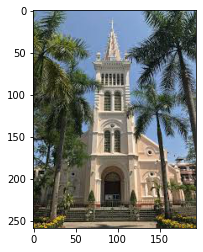

[1, 1, 1, 1, 0, 0, 0, 0, 0, 0]
0.4

Chùa bà -Bình Dương


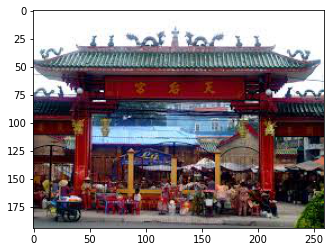

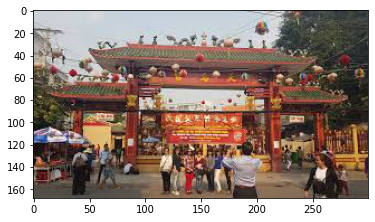

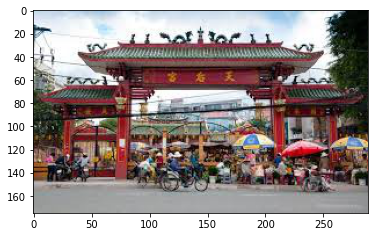

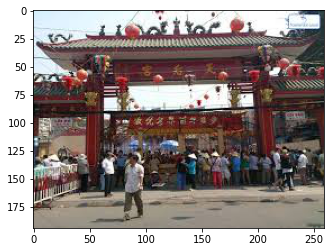

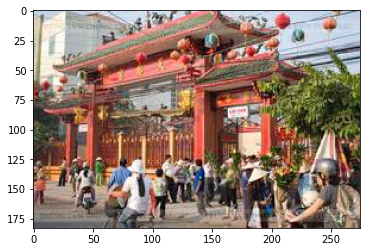

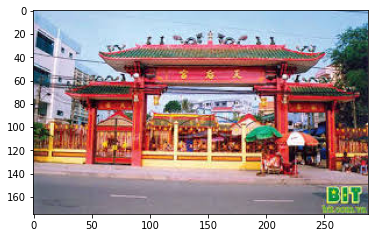

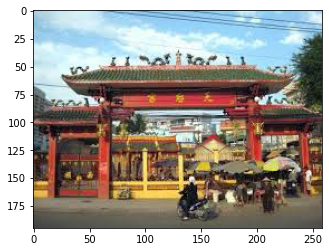

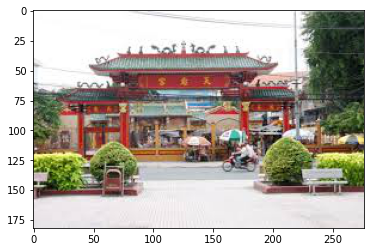

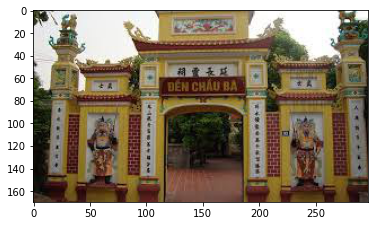

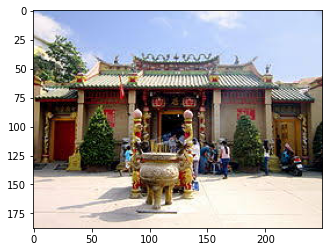

[1, 1, 1, 1, 1, 1, 1, 1, 0, 1]
0.89

 MAP: 0.8464814814814815


In [119]:
# MAP cho L2
MAP_L2=[]
for query in queryS:
  from keras.preprocessing import image # để fix bug
  relationS = []
  path = "/content/drive/My Drive/Truy_van/Test_Image_MAP/{}.jfif".format(query)
  relative_imageS = get_relative_images_L2(path)

  print('\n'+dictionarieS[query])
  for img in relative_imageS[:10]:
    image = mpimg.imread(img[0])
    imgplot = plt.imshow(image)
    plt.show()

    if query in img[0]:
      relationS.append(1)
    else:
      relationS.append(0)
  print(relationS)
  relationS = np.asarray(relationS)
  AP_metric = AP(relationS,10)
  MAP_L2.append(AP_metric)
  print(AP_metric)
print('\n MAP:', sum(MAP_L2)/6)


Chùa một cột


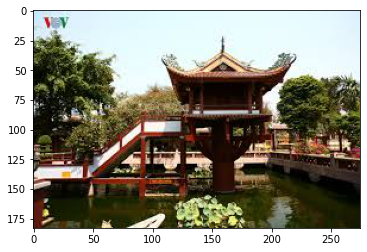

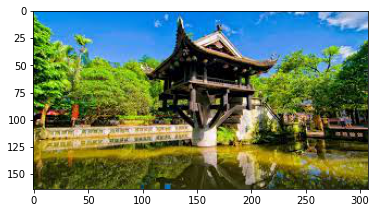

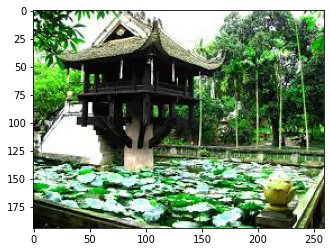

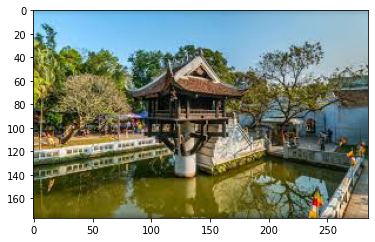

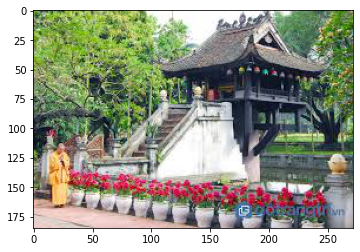

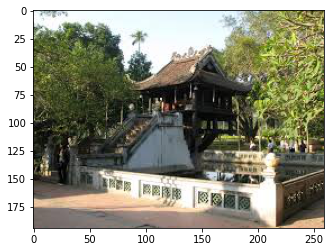

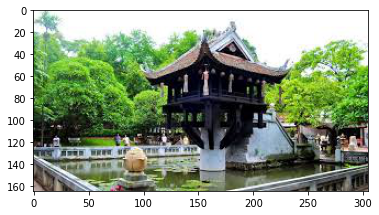

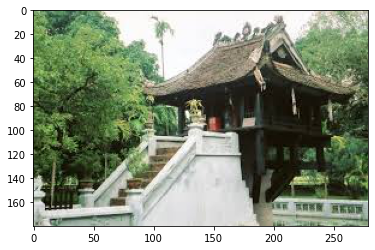

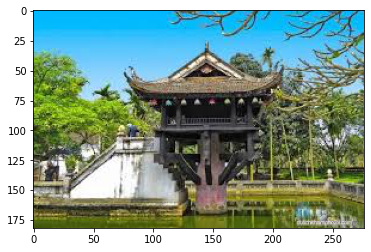

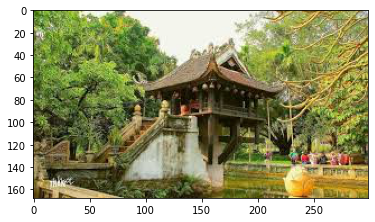

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Nhà thờ đức bà


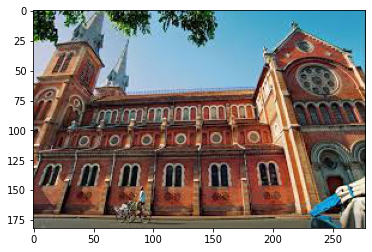

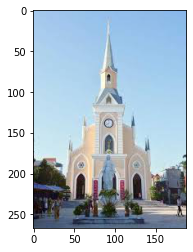

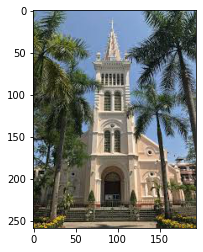

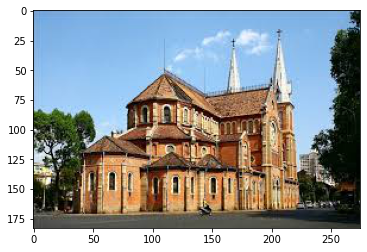

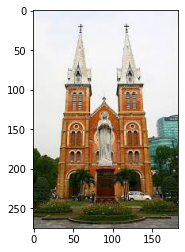

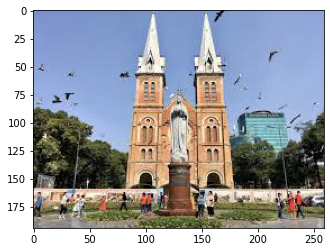

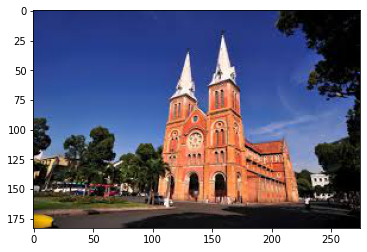

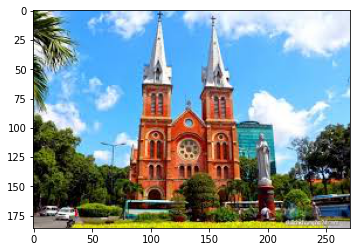

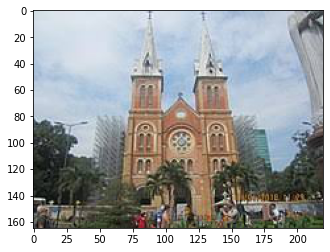

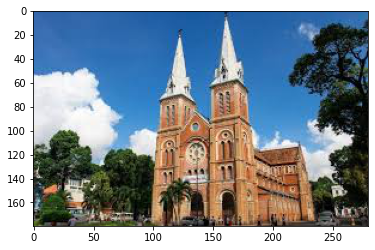

[1, 0, 0, 1, 1, 1, 1, 1, 1, 1]
0.5808730158730159

Bò sữa


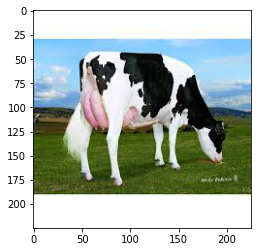

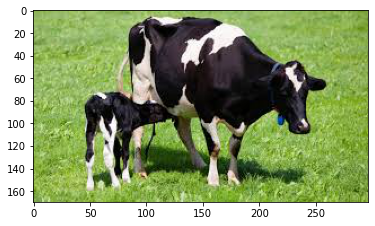

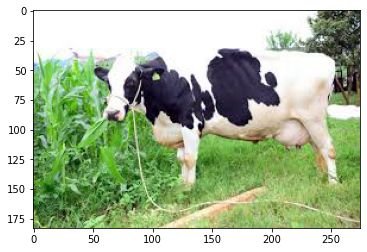

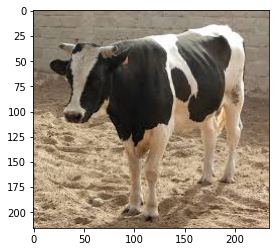

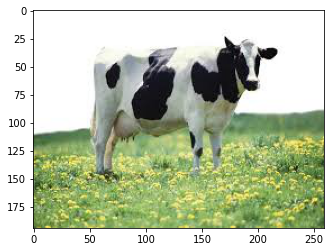

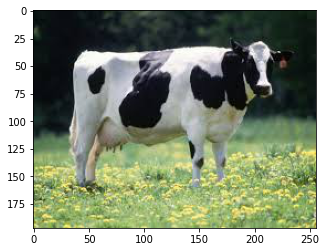

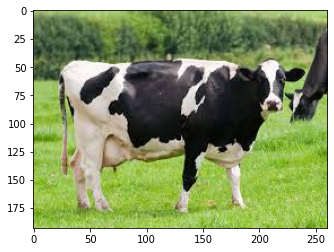

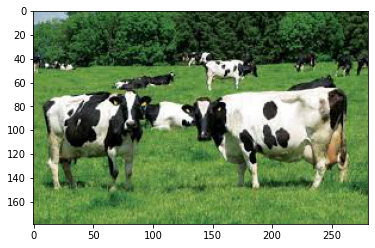

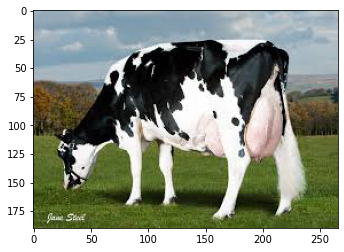

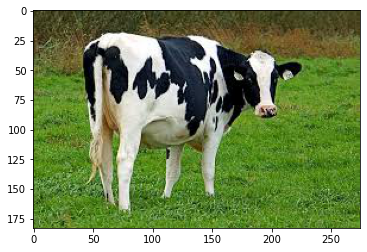

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Ruộng bậc thang


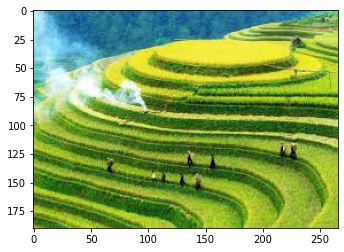

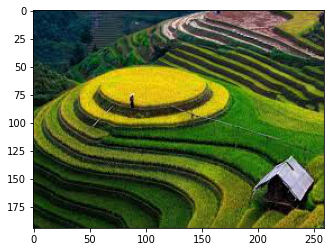

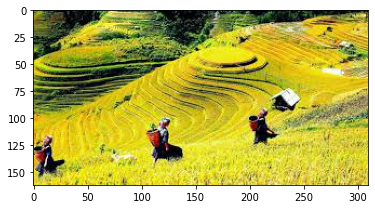

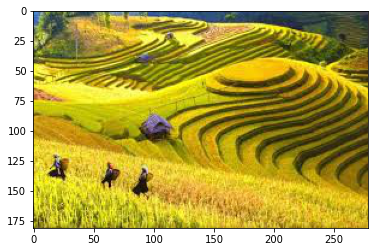

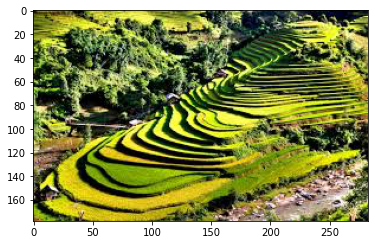

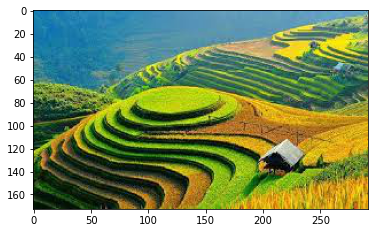

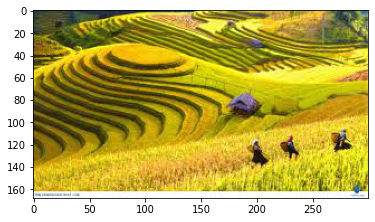

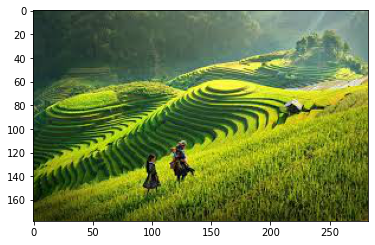

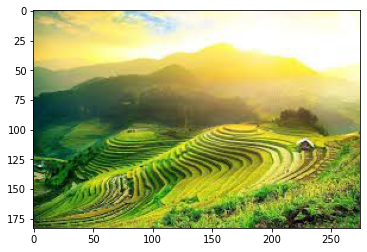

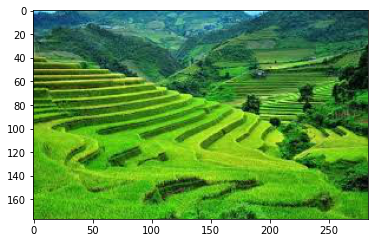

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Tay phật - Đà Nẵng


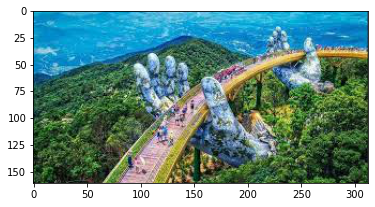

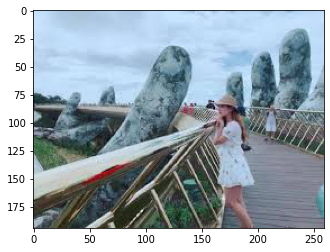

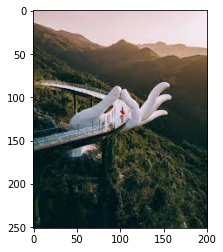

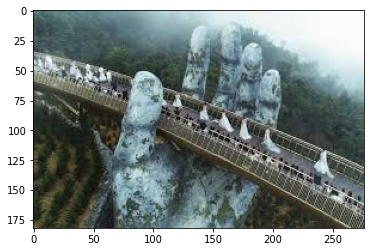

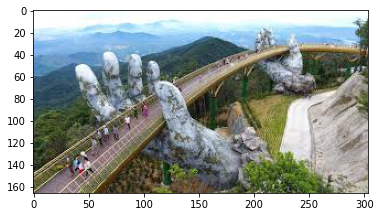

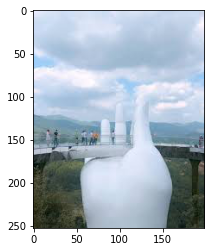

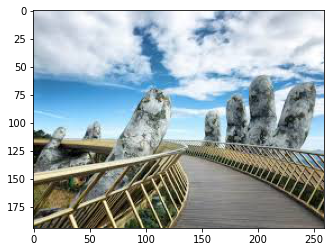

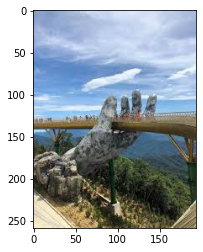

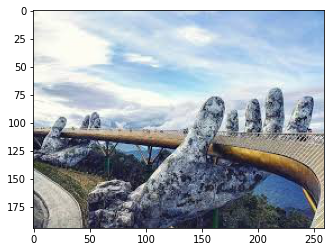

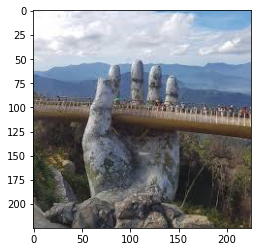

[1, 1, 0, 1, 1, 0, 1, 1, 1, 1]
0.6592063492063491

Chùa bà -Bình Dương


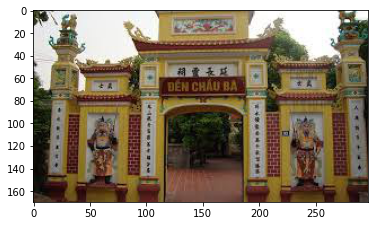

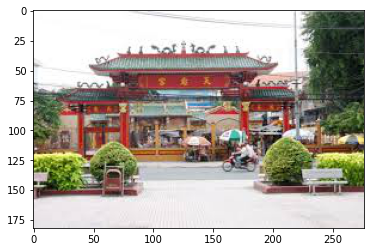

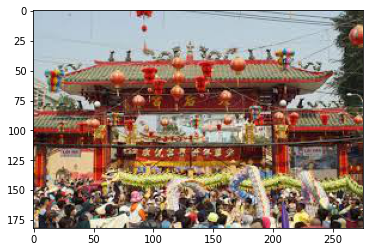

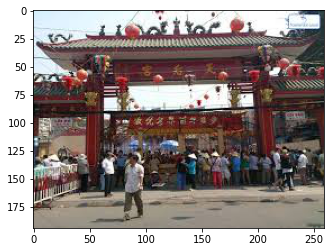

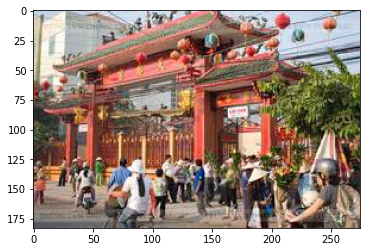

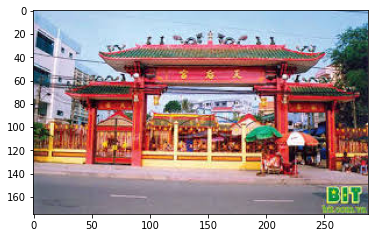

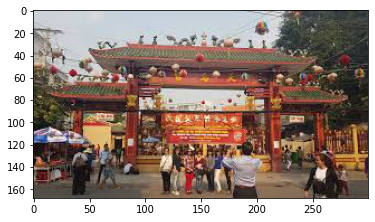

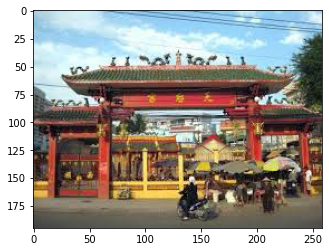

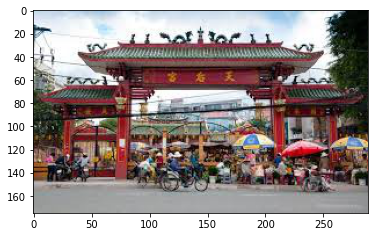

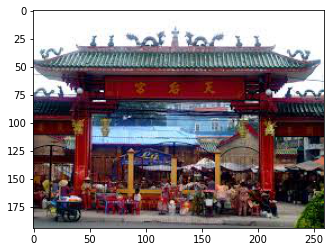

[0, 1, 1, 1, 1, 1, 1, 1, 1, 1]
0.7071031746031746

 MAP: 0.8245304232804233


In [121]:
#MAP cho Cosine
MAP_Cosine=[]
for query in queryS:
  from keras.preprocessing import image
  relationS = []
  path = "/content/drive/My Drive/Truy_van/Test_Image_MAP/{}.jfif".format(query)
  relative_imageS = get_relative_images_Cosin(path)

  print('\n'+dictionarieS[query])
  for img in relative_imageS[-10:]:
    image = mpimg.imread(img[0])
    imgplot = plt.imshow(image)
    plt.show()

    if query in img[0]:
      relationS.append(1)
    else:
      relationS.append(0)
  print(relationS)
  relationS = np.asarray(relationS)
  AP_metric = AP(relationS,10)
  MAP_Cosine.append(AP_metric)
  print(AP_metric)
print('\n MAP:', sum(MAP_Cosine)/6)


Chùa một cột


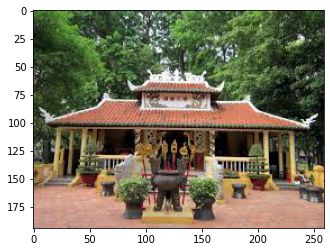

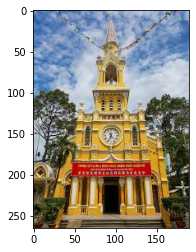

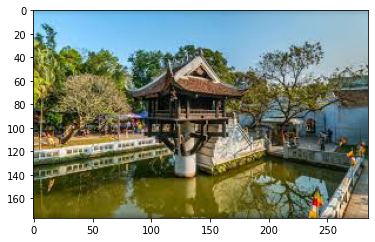

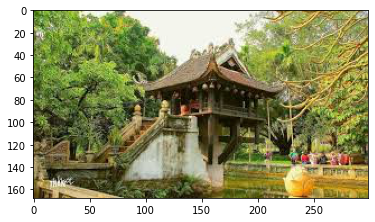

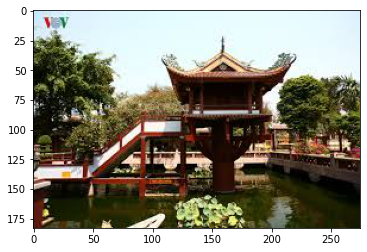

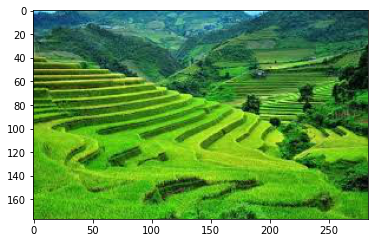

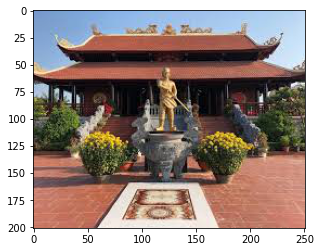

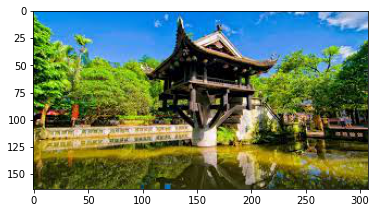

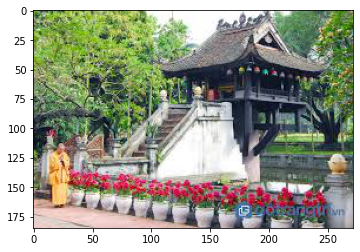

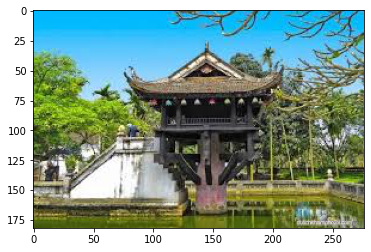

[0, 0, 1, 1, 1, 0, 0, 1, 1, 1]
0.3088888888888889

Nhà thờ đức bà


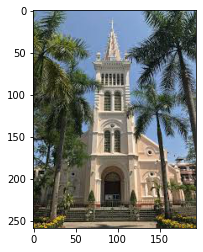

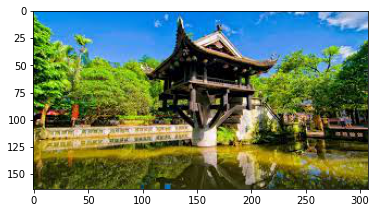

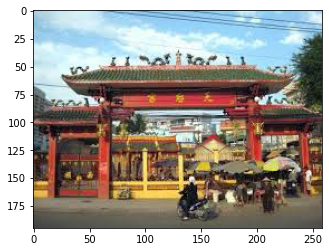

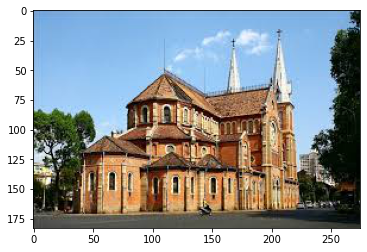

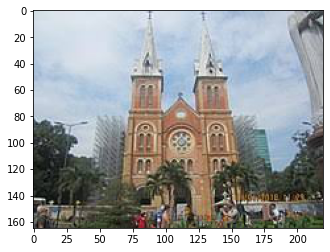

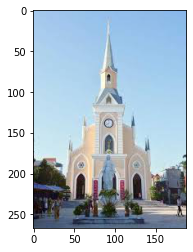

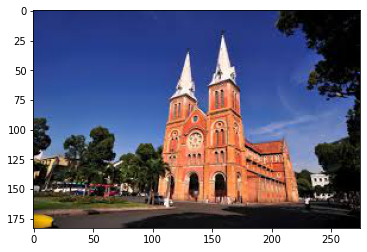

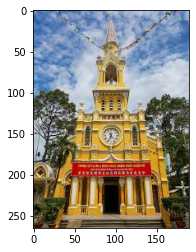

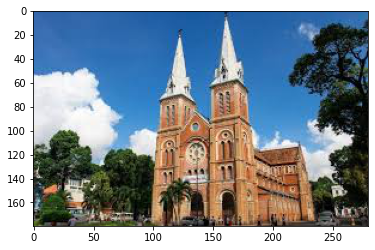

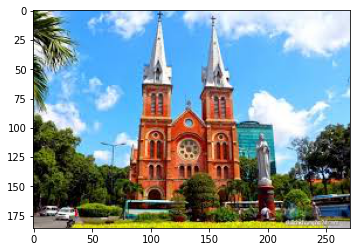

[0, 0, 0, 1, 1, 0, 1, 0, 1, 1]
0.2023015873015873

Bò sữa


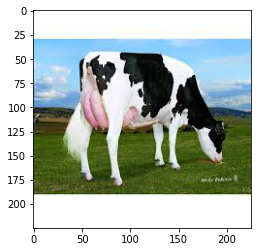

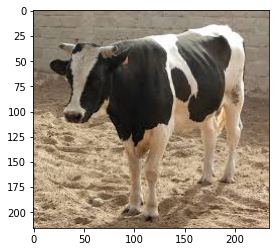

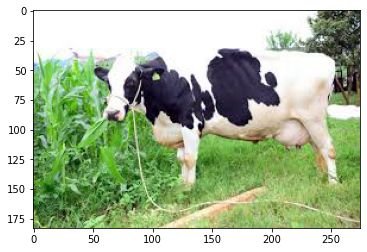

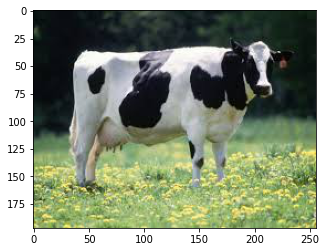

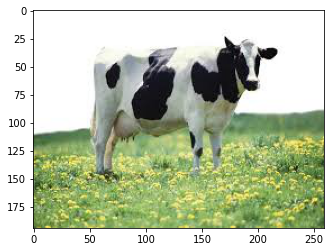

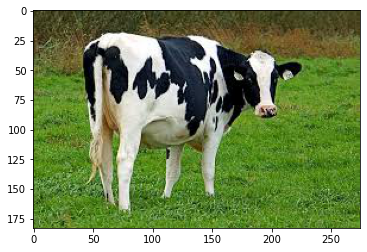

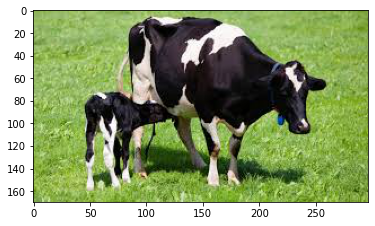

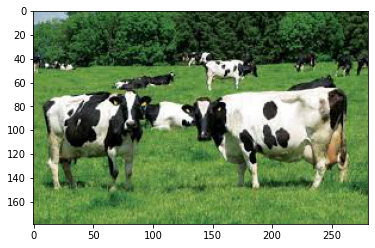

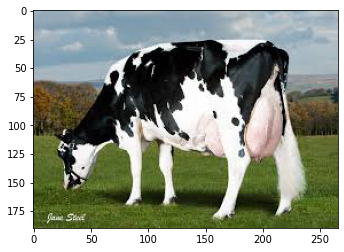

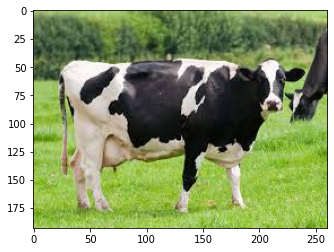

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Ruộng bậc thang


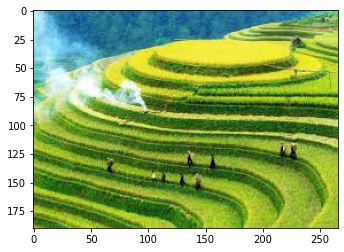

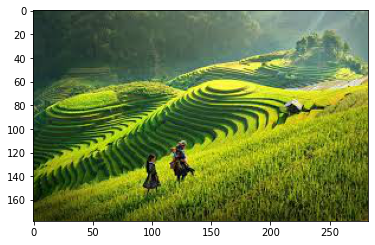

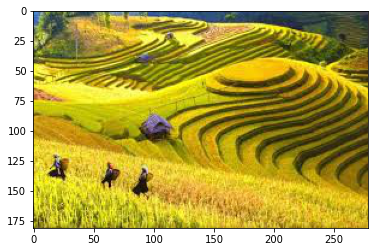

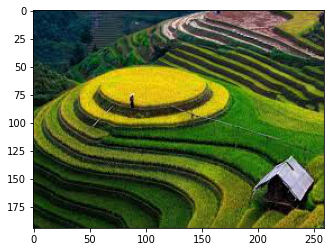

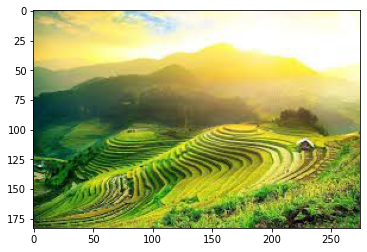

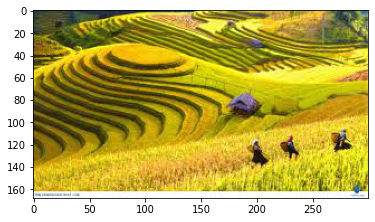

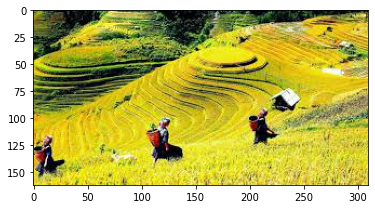

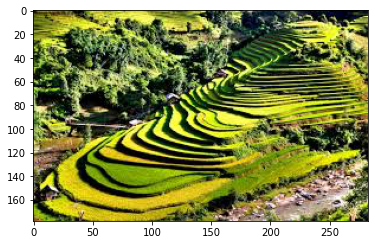

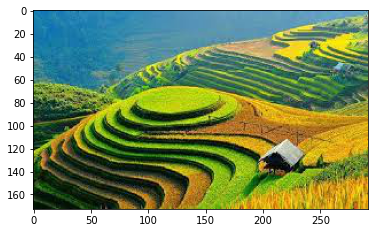

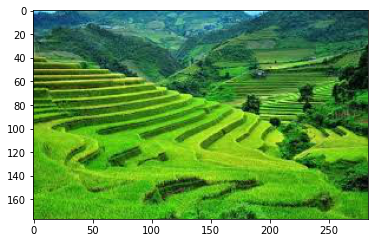

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
1.0

Tay phật - Đà Nẵng


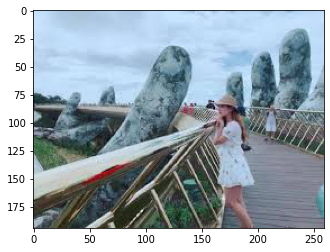

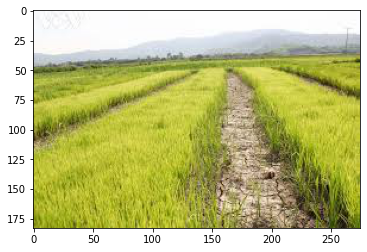

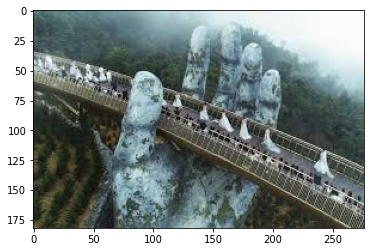

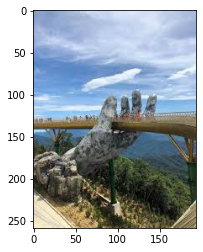

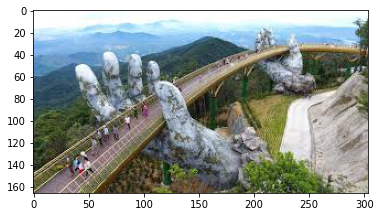

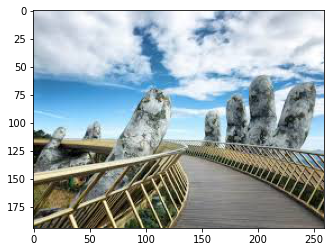

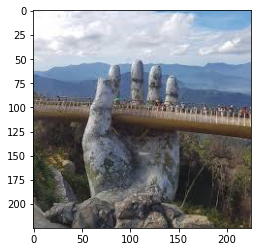

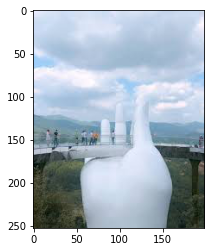

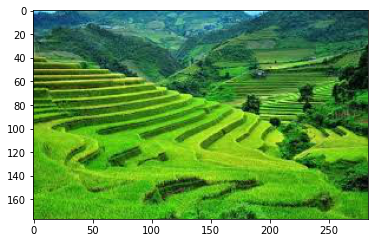

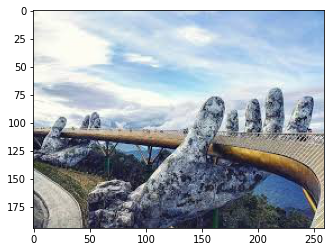

[1, 0, 1, 1, 1, 1, 1, 0, 0, 1]
0.5607142857142857

Chùa bà -Bình Dương


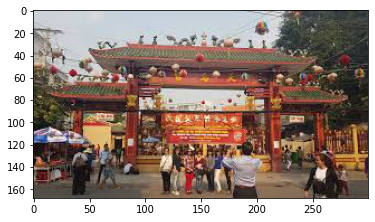

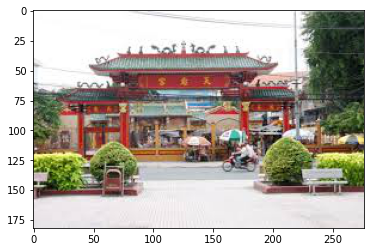

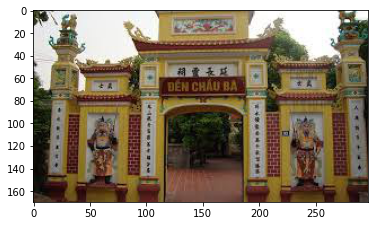

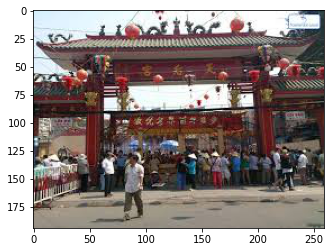

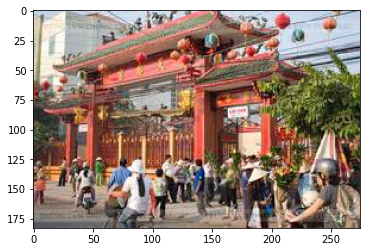

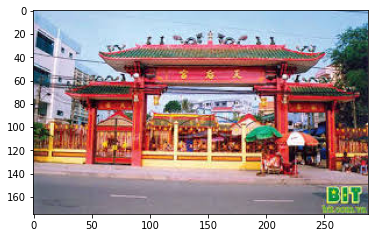

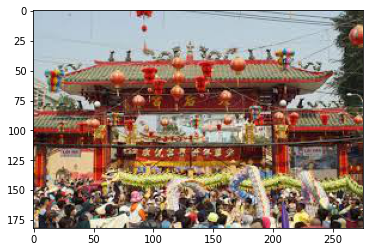

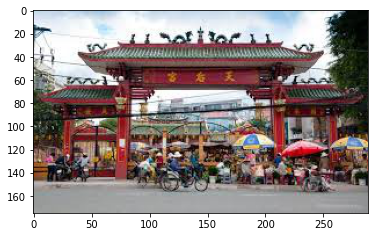

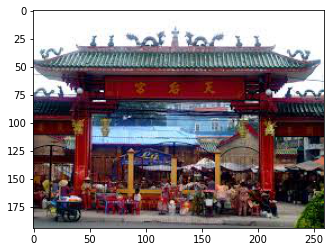

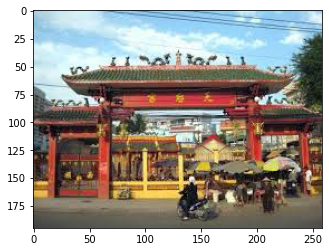

[1, 1, 0, 1, 1, 1, 1, 1, 1, 1]
0.7904365079365079

 MAP: 0.643723544973545


In [123]:
#MAP cho tích vô hướng
MAP_inner=[]
for query in queryS:
  from keras.preprocessing import image
  relationS = []
  path = "/content/drive/My Drive/Truy_van/Test_Image_MAP/{}.jfif".format(query)
  relative_imageS = get_relative_images_Inner_product(path)

  print('\n'+dictionarieS[query])
  for img in relative_imageS[-10:]:
    image = mpimg.imread(img[0])
    imgplot = plt.imshow(image)
    plt.show()

    if query in img[0]:
      relationS.append(1)
    else:
      relationS.append(0)
  print(relationS)
  relationS = np.asarray(relationS)
  AP_metric = AP(relationS,10)
  MAP_inner.append(AP_metric)
  print(AP_metric)
print('\n MAP:', sum(MAP_inner)/6)

In [127]:
# So sánh
print('MAP L2:           ', sum(MAP_L2)/6)
print('MAP Consine:      ', sum(MAP_Cosine)/6)
print('MAP tích vô hương:', sum(MAP_inner)/6)

MAP L2:            0.8464814814814815
MAP Consine:       0.8245304232804233
MAP tích vô hương: 0.643723544973545
